In [1]:
import pathlib
import numpy as np
import scipy as sp
from matplotlib import pyplot as plt
import astropy as ast
from astropy import stats
import pandas as pd

import SessionTools.two_photon as st2p

plt.rcParams['pdf.fonttype']=42

%load_ext autoreload
%autoreload 2 


%matplotlib inline

In [2]:
basedir = pathlib.Path('/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a')
# basedir = pathlib.Path('/media/mplitt/SSD_storage/2P_scratch/ER4d_iGABASnFR2_EPG_jRGECO1a')
sess_df = pd.read_csv(basedir / 'sessions.csv')
sess_df['fly_id'] = [row['date']+'_'+row['fly'] for _, row in sess_df.iterrows()]


figfolder = pathlib.Path('/media/mplitt/SSD_storage/fig_scratch/EL_meetings/ER4d_sytjGCaMP7f_EPG_jRGECO1a/')
# figfolder = pathlib.Path('/media/mplitt/SSD_storage/fig_scratch/EL_meetings/ER4d_iGABASnFR2_EPG_jRGECO1a/')
figfolder.mkdir(parents=True, exist_ok=True)

In [3]:
ol_mask = (sess_df['open_loop']==1) & (sess_df['usable']==1) & \
         (sess_df['terminals_only']==1) & (sess_df['LexA_line']=='R27F02') & \
         (sess_df['dark_trained']<1) & (sess_df['mianserin']<1)
# ol_mask = (sess_df['open_loop']==1) & (sess_df['usable']==1) & \
#          (sess_df['terminals_only']==1) & (sess_df['LexA_line']=='R27F02') & \
#          (sess_df['mianserin']<1)
# ol_mask = (sess_df['open_loop']==1) & (sess_df['usable']==1) 
ol_mask.sum()

20

In [4]:
ol_sess_df = sess_df.loc[ol_mask]

In [5]:
print(ol_sess_df.columns)

Index(['date', 'fly', 'sess', 'closed_loop', 'usable', 'terminals_only',
       'open_loop', 'dark_trained', 'DA', 'OA', 'mianserin', 'LexA_line',
       'fictrac_scan_num', 'fictrac_dat_file', 'notes', 'fly_id'],
      dtype='object')


In [6]:
def get_ts(pp, coef = .7):
    y_r4d = pp.timeseries['rois_R4d_z']
    y_epg = pp.timeseries['rois_EB_z']
    heading = np.angle(np.exp(1j*(-1*pp.voltage_recording_aligned[' Heading'].to_numpy()-np.pi)))
    bar_vis_mask = (pp.voltage_recording_aligned[' Arena DAC2']<7) *(np.abs(heading)<2.5) 
    
    if coef ==0:
        y_r4d-=1
        # # # # # y_r4d = y_r4d-np.mean(y_r4d,axis=1,keepdims=True)
        y_epg -=1
        # y_r4d_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_r4d, 2, axis=-1),.7,axis=1, mode='wrap')
        # y_epg_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_epg, 2, axis=-1),.7,axis=1, mode='wrap')
        y_r4d_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_r4d,.7,axis=1, mode='wrap'), 2, axis=-1)
        y_epg_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_epg,.7,axis=1, mode='wrap'), 2, axis=-1)
        # y_r4d_sm = sp.ndimage.gaussian_filter1d(y_r4d, 1, axis=-1)
        # y_epg_sm = sp.ndimage.gaussian_filter1d(y_epg, 1, axis=-1)
    else:        
        y_r4d[1,:,:] -= coef*y_r4d[0,:,:]-coef
        y_epg[0,:,:] -= coef*y_epg[1,:,:] -coef #- y_epg[1,:,:].mean(axis=-1, keepdims=True)
        y_r4d_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_r4d-1, 1, axis=-1),.5,axis=1, mode='wrap')
        y_epg_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_epg-1, 1, axis=-1),.5,axis=1, mode='wrap')

    y_r4d_norm = y_r4d_sm-y_r4d_sm.mean(axis=1,keepdims=True)
#     y_r4d[1,:,:] = np.maximum(y_r4d[1,:,:] - coef*y_r4d[0,:,:],0) + coef*y_r4d[0,:,:].mean(axis=-1,keepdims=True)
    
    
#     y_r4d_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_r4d-1, 2, axis=-1),.7,axis=1, mode='wrap')
    
    
#     y_epg[0,:,:] = np.maximum(y_epg[0,:,:]-coef*y_epg[1,:,:],0) + coef*y_epg[1,:,:].mean(axis=-1,keepdims=True)
    
#     y_epg_sm = sp.ndimage.gaussian_filter1d(sp.ndimage.gaussian_filter1d(y_epg-1, 2, axis=-1),.7,axis=1, mode='wrap')
    
    
    n_rois = y_r4d.shape[1]
    x_f,y_f = st2p.utilities.pol2cart(y_r4d_sm[1,:,:] ,np.linspace(-np.pi,np.pi,num=n_rois)[:,np.newaxis])
    rho_r4d, phi_r4d = st2p.utilities.cart2pol(x_f.mean(axis=0), y_f.mean(axis=0))

    x_f,y_f = st2p.utilities.pol2cart(y_epg_sm[0,:,:],np.linspace(-np.pi,np.pi,num=n_rois)[:,np.newaxis])
    rho_epg, phi_epg = st2p.utilities.cart2pol(x_f.mean(axis=0), y_f.mean(axis=0))

    _,offset_r4d = st2p.utilities.cart2pol(*st2p.utilities.pol2cart(np.ones(heading.shape),phi_r4d-heading))
    _,offset_epg = st2p.utilities.cart2pol(*st2p.utilities.pol2cart(np.ones(heading.shape),phi_epg-heading))
    
    return {'heading': heading,
            'bar_vis_mask': bar_vis_mask,
            'y_r4d': y_r4d,
            'y_epg': y_epg,
            'y_r4d_sm': y_r4d_sm,
            'y_r4d_norm': y_r4d_norm,
            'y_epg_sm': y_epg_sm,
            'rho_r4d': rho_r4d,
            'phi_r4d': phi_r4d,
            'offset_r4d': offset_r4d,
            'rho_epg': rho_epg,
            'phi_epg': phi_epg,
            'offset_epg': offset_epg}

def align_to_heading(ts):
    heading_bins = np.linspace(-np.pi, np.pi, num=17)
    heading_dig = np.digitize(ts['heading'], heading_bins)-1

    y_h_aligned = np.zeros_like(ts['y_epg_sm'])
    for ind in range(ts['heading'].shape[0]):
        b = np.argmax(ts['y_epg_sm'][0,:,ind])
        # y_h_aligned[0,:,ind] = np.roll(ts['y_epg_sm'][0,:,ind], -b)
        # y_h_aligned[1,:,ind] = np.roll(ts['y_r4d_sm'][1,:,ind], -b)
        y_h_aligned[0,:,ind] = np.roll(ts['y_epg_sm'][0,:,ind], -heading_dig[ind])
        y_h_aligned[1,:,ind] = np.roll(ts['y_r4d_sm'][1,:,ind], -heading_dig[ind])
        
    y_h_aligned_z = np.zeros((2,16,16))
    for b in range(16):
        mask = heading_dig==b
        y_h_aligned_z[:,:,b] = y_h_aligned[:,:,mask].mean(axis=-1)
    

    
    
    return heading_bins, y_h_aligned, y_h_aligned_z

   

In [7]:
row = ol_sess_df.iloc[0]

/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/01_04_2024/fly1/open_loop-005/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/02_04_2024/fly1/open_loop-002/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/04_04_2024/fly1/open_loop-004/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/05_04_2024/fly1/open_loop-002/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/09_04_2024/fly1/open_loop-004/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/09_04_2024/fly2/open_loop-004/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/29_04_2024/fly2/open_loop-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/29_04_2024/fly3/open_loop-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/29_04_2024/fly4/open_loop-000/preproc

/tmp/ipykernel_1052522/172672306.py:39: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax= plt.subplots(6,1, figsize=[15,18], sharex=True)


/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/30_04_2024/fly3/open_loop-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/01_05_2024/fly2/open_loop-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/01_05_2024/fly3/open_loop-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/02_05_2024/fly2/open_loop-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/03_05_2024/fly3/open_loop-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/03_05_2024/fly4/open_loop-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/20_05_2024/fly1/open_loop-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/20_05_2024/fly3/open_loop-000/preprocess.pkl
/media/mplitt/SSD_storage/2P_scratch/ER4d_sytjGCaMP7f_EPG_jRGECO1a/20_05_2024/fly4/open_loop-000/preproc

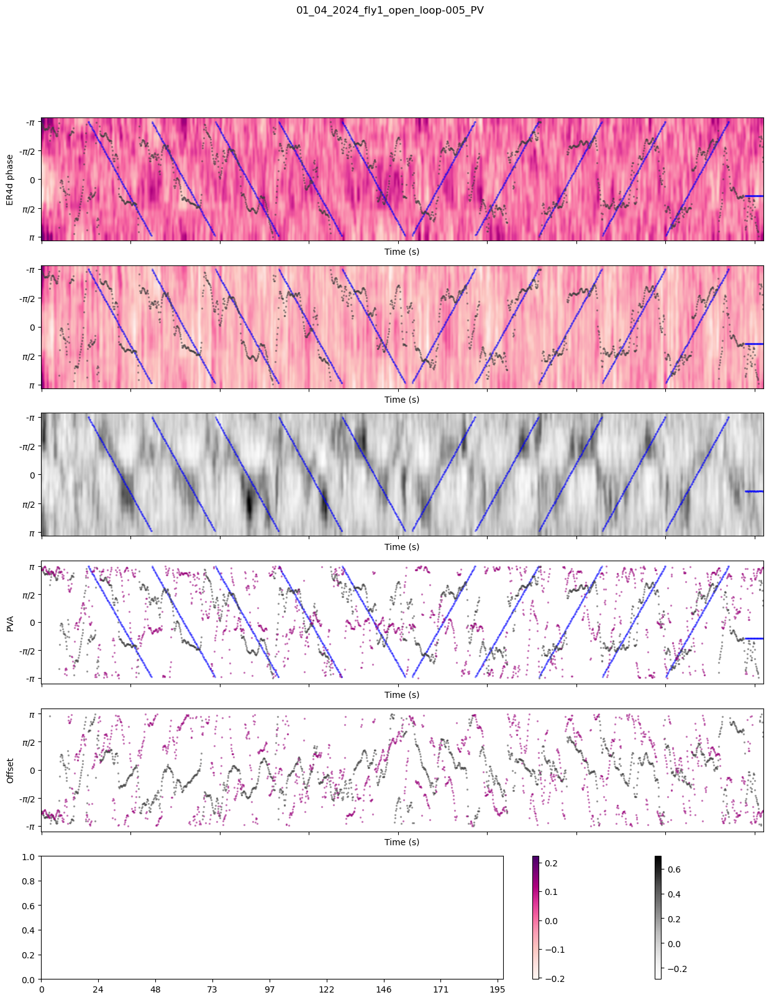

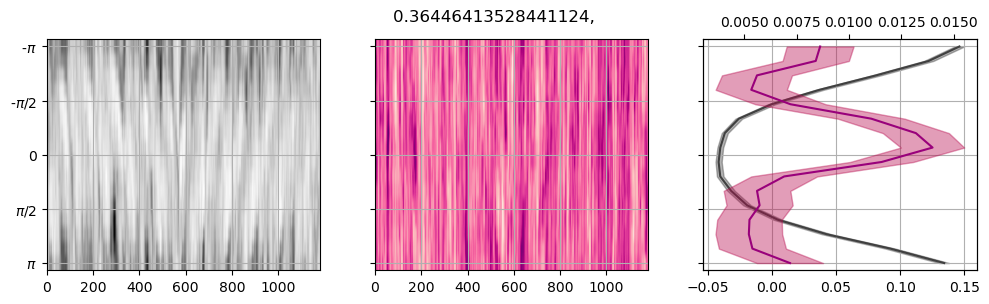

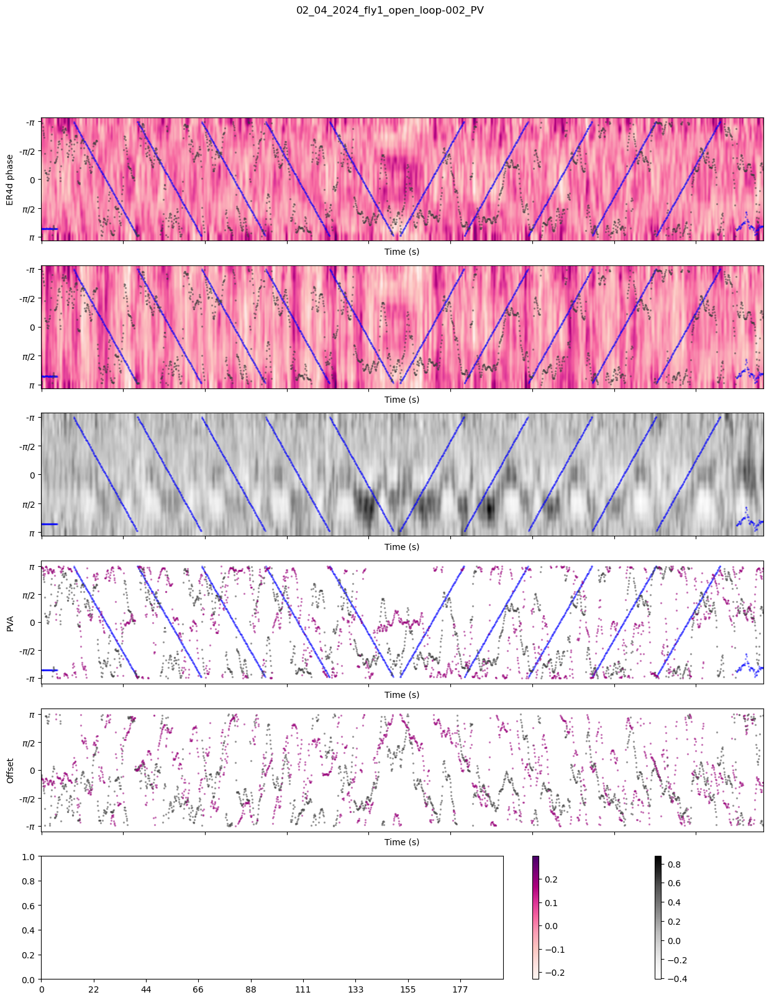

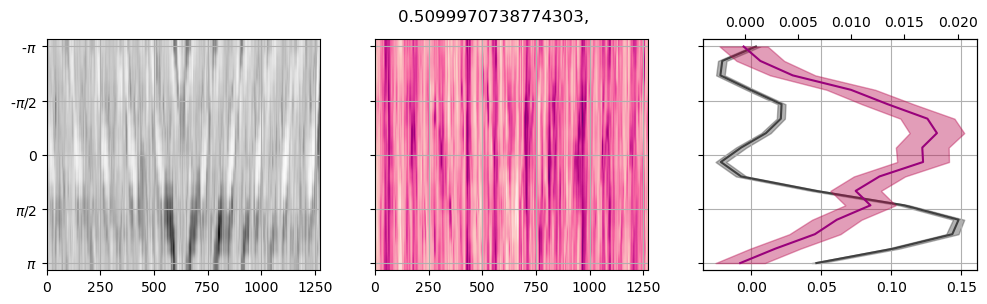

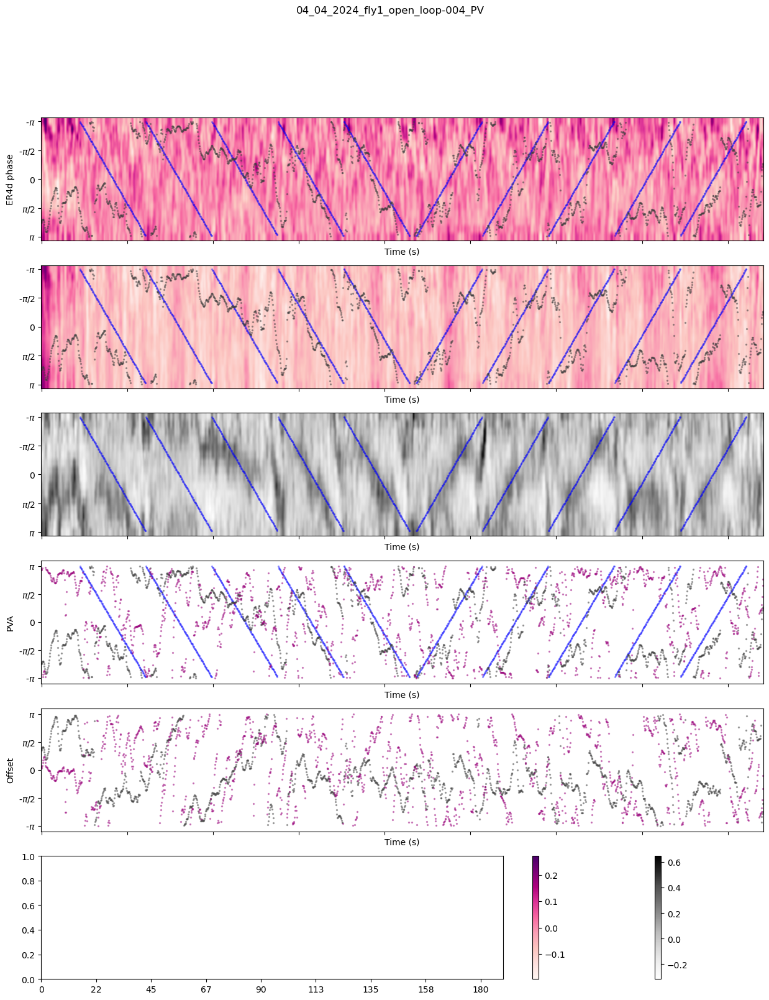

...

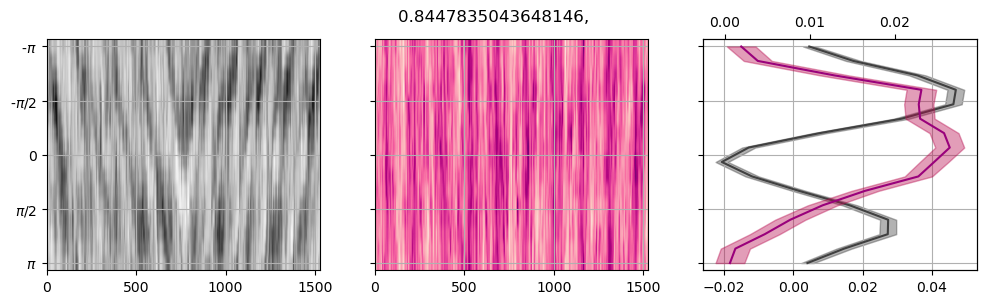

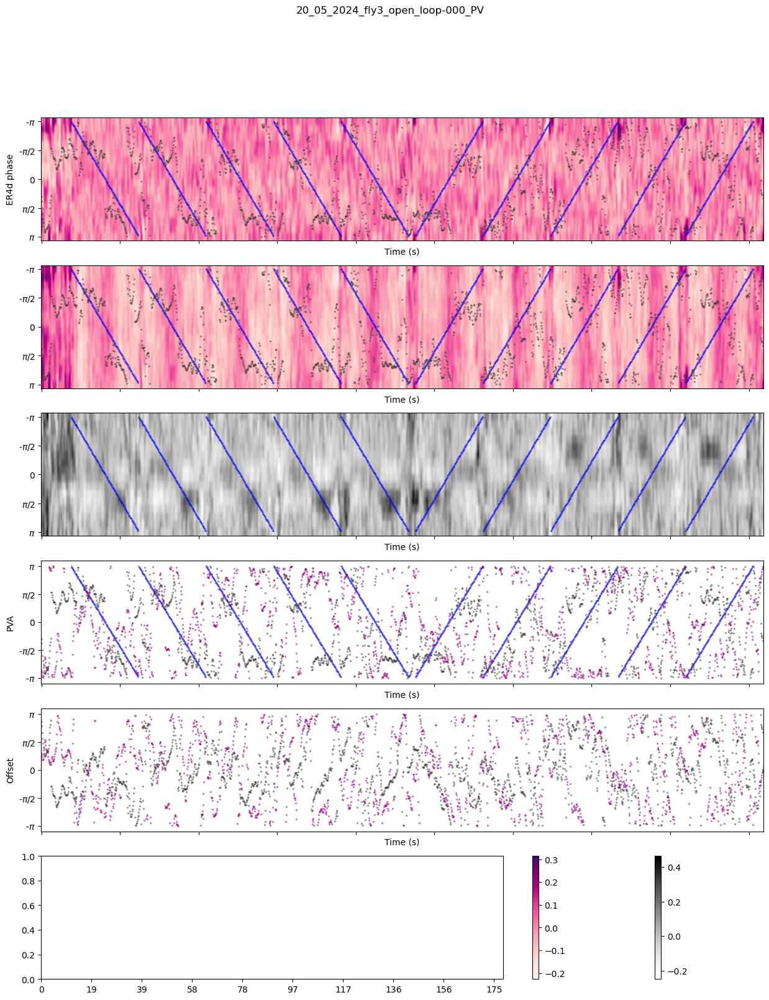

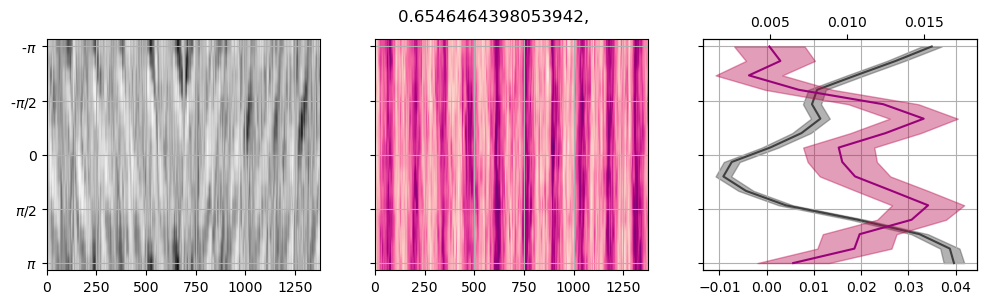

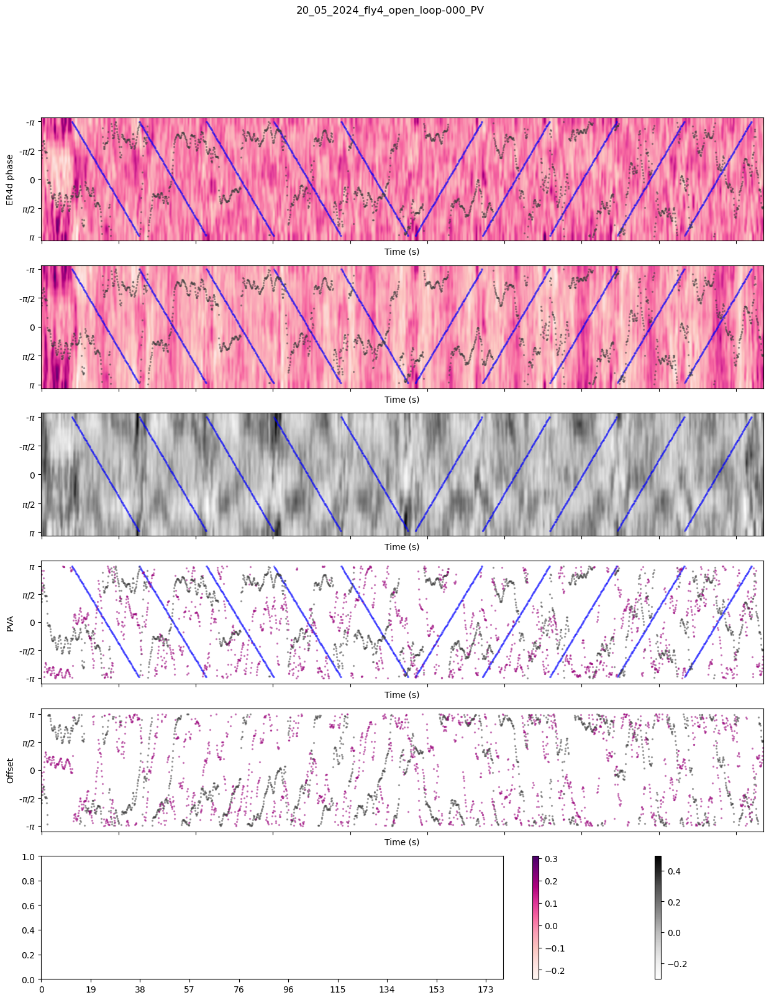

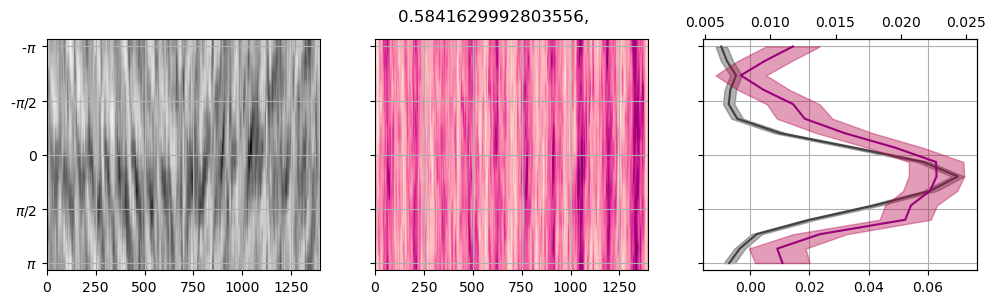

In [8]:
epg_all, epg_all_b = [], []
r4d_all, r4d_all_b = [], []
offset_all = []
for _, row in ol_sess_df.iterrows():
    if row['dark_trained']==1:
        if row['mianserin']==1:
            skip = True
            outdir = pathlib.PurePath( basedir / 'mianserin' / row['date'] / row['fly'] / row['sess'] / 'preprocess.pkl')
        elif row['OA']==1:
            skip = True
            outdir = pathlib.PurePath( basedir / 'bath_OA' / row['date'] / row['fly'] / row['sess'] / 'preprocess.pkl')
        else:    
            skip = True
            outdir = pathlib.PurePath( basedir / 'dark_trained' / row['date'] / row['fly'] / row['sess'] / 'preprocess.pkl')
            
        
    else: 
        skip = False
        outdir = pathlib.PurePath( basedir / row['date'] / row['fly'] / row['sess'] / 'preprocess.pkl')
        
    if not skip:
        pp = st2p.preprocessing.EBImagingSession.from_file(outdir)
        print(outdir)
        y_r4d = pp.calculate_zscored_F('rois_R4d', exp_detrend=True,zscore=False,reg_other_channel=False)
        y_epg = pp.calculate_zscored_F('rois_EB', exp_detrend=True,zscore=False, reg_other_channel=True)
        
        # y_r4d = sp.stats.zscore(y_r4d,axis=1)
        # y_r4d = pp.calculate_zscored_F('rois_R4d', exp_detrend=True,zscore=False,reg_other_channel=False)
        # y_epg = pp.calculate_zscored_F('rois_EB', exp_detrend=True,zscore=False, reg_other_channel=True)
        dt = pp.metadata['frame_period']*pp.metadata['layout']['frames_per_sequence']
        ts = get_ts(pp, coef=0)

        heading_bins, y_h_aligned, y_h_aligned_z = align_to_heading(ts)
        mask = (np.abs(ts['heading'])<2.5)&(pp.voltage_recording_aligned[' Y/Index']<2)
        index_mask = 1.*(pp.voltage_recording_aligned[' Y/Index']<2)
        index_mask[index_mask==0]=np.nan
        

        fig, ax= plt.subplots(6,1, figsize=[15,18], sharex=True)
        alpha = ts['y_epg_sm'][0,::-1,:]
        alpha = (alpha - np.amin(alpha))/(np.amax(alpha)-np.amin(alpha))
        alpha[alpha<.2]=0

        # h = ax[0].imshow(ts['y_epg_sm'][0,::-1,:], aspect='auto', cmap= 'Greys', alpha=alpha,vmin=-.1, vmax=.3)

        alpha = ts['y_r4d_sm'][1,::-1,:]
        alpha = (alpha - np.amin(alpha))/(np.amax(alpha)-np.amin(alpha))
        alpha[alpha<.2]=0
        # hh = ax[0].imshow(ts['y_r4d_sm'][1,::-1,:], aspect='auto', cmap= 'RdPu', alpha = alpha)
        hh = ax[0].imshow(ts['y_r4d_norm'][1,::-1,:], aspect='auto', cmap= 'RdPu')#, vmin=-.4,vmax=.4)



        ax[1].imshow(ts['y_r4d_sm'][1,::-1,:], aspect='auto', cmap= 'RdPu')#, vmin=-.1, vmax=.7)
        h=ax[2].imshow(ts['y_epg_sm'][0,::-1,:], aspect='auto', cmap= 'Greys')#, vmin=-.1, vmax=.7)
        ax[0].set_ylabel('ER4d/EPG phase')
        ax[0].set_ylabel('EPG phase')
        ax[0].set_ylabel('ER4d phase')


        for a in range(3):
            ax[a].set_yticks([r/2/np.pi*15 for r in (0,  np.pi/2,  np.pi,  6*np.pi/4,  2*np.pi)], 
                                                     labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])


        t = np.arange(0,dt*y_h_aligned.shape[-1], dt)
        for a in range(5):
            ax[a].set_xticks(np.arange(t.shape[0])[::200], labels=[int(_t) for _t in  t[::200]])
            ax[a].set_xlabel('Time (s)')



        x = np.arange(ts['y_epg'].shape[-1])
        heading_ = 15-15*(ts['heading']+np.pi)/2/np.pi
        ax[0].scatter(x, heading_*index_mask, alpha=.3, s=2, color='blue')
        ax[1].scatter(x, heading_*index_mask, alpha=.3, s=2, color='blue')
        ax[2].scatter(x, heading_*index_mask, alpha=.3, s=2, color='blue')
        ax[3].scatter(x, ts['heading']*index_mask, alpha=.3, s=2, color='blue')
        ax[3].scatter(x, ts['phi_epg'], color=plt.cm.Greys(.8), alpha = .4, s=2)
        ax[3].scatter(x, ts['phi_r4d'], color=plt.cm.RdPu(.8), alpha = .4, s=2)
        
        ax[0].scatter(x, 15-15*(ts['phi_epg']+np.pi)/2/np.pi, color=plt.cm.Greys(.8), alpha = .4, s=2)
        ax[1].scatter(x, 15-15*(ts['phi_epg']+np.pi)/2/np.pi, color=plt.cm.Greys(.8), alpha = .4, s=2)
        ax[3].set_ylabel('PVA')

        ax[4].scatter(x, ts['offset_epg'], color=plt.cm.Greys(.8), alpha = .4, s=2)
        ax[4].scatter(x, ts['offset_r4d'], color=plt.cm.RdPu(.8), alpha = .4, s=2)
        ax[4].set_ylabel('Offset')

        fig.colorbar(h, ax=ax[5])
        fig.colorbar(hh, ax=ax[5])
        for a in range(3,5):
            ax[a].set_yticks([r for r in (-np.pi,  -np.pi/2,  0,  np.pi/2,  np.pi)], 
                                                     labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])

        fig.suptitle(f"{row['fly_id']}_{row['sess']}_PV")

        # fig.savefig(eg_folder / f"{row['fly_id']}_{row['sess']}_PV.pdf")

        fig, ax = plt.subplots(1,3,figsize=[12,3], sharey=True)
        ax[0].imshow(y_h_aligned[0,:,:][:,mask],aspect='auto',cmap='Greys')#, vmin=-.1, vmax=.3)
        ax[1].imshow(y_h_aligned[1,:,:][:,mask],aspect='auto',cmap='RdPu') #, vmin = -.1,vmax=.3)


        epg_all.append(y_h_aligned[0,:,:][:,mask].mean(axis=-1))
        epg_all_b.append(y_h_aligned[0,:,:][:,~mask].mean(axis=-1))

        r4d_all.append(y_h_aligned[1,:,:][:,mask].mean(axis=-1))
        r4d_all_b.append(y_h_aligned[1,:,:][:,~mask].mean(axis=-1))



        centers = (heading_bins[:-1]+heading_bins[1:])/2
        x = np.arange(16)
        ha_avg_epg = y_h_aligned[0,:,:][:,mask].mean(axis=-1)
        ha_sem_epg = sp.stats.sem(y_h_aligned[0,:,:][:,mask],axis=-1)
        ax[2].plot(ha_avg_epg, x, color=plt.cm.Greys(.8))
        ax[2].fill_betweenx(x, ha_avg_epg - ha_sem_epg, ha_avg_epg + ha_sem_epg, color= plt.cm.Greys(.8), alpha=.4)

        ha_avg_r4d = y_h_aligned[1,:,:][:,mask].mean(axis=-1)
        ha_sem_r4d = sp.stats.sem(y_h_aligned[1,:,:][:,mask],axis=-1)
        axx = ax[2].twiny()
        axx.plot(ha_avg_r4d, x,color=plt.cm.RdPu(.8))
        axx.fill_betweenx(x, ha_avg_r4d - ha_sem_r4d, ha_avg_r4d + ha_sem_r4d, color= plt.cm.PuRd(.8), alpha=.4)

        for a in ax:
            a.grid(True)
            a.set_yticks([r/2/np.pi*15 for r in (0,  np.pi/2,  np.pi,  6*np.pi/4,  2*np.pi)], 
                                                     labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])

        circorr = ast.stats.circcorrcoef(ts['heading'][mask], ts['phi_epg'][mask])
        offset_var = sp.stats.circvar(ts['offset_epg'][mask])
        offset_all.append(offset_var)
        fig.suptitle(f"{offset_var}, ")
        # fig.savefig(eg_folder / f"{row['fly_id']}_{row['sess']}_heading_centered.pdf")

20
[ 0 11  5  8 10  4 14  1  2 15 19 13  6 18  9  7 12 16  3 17]
2.560425352603456 0.019130986238375332
2.4901870306559375 0.022194535180574418


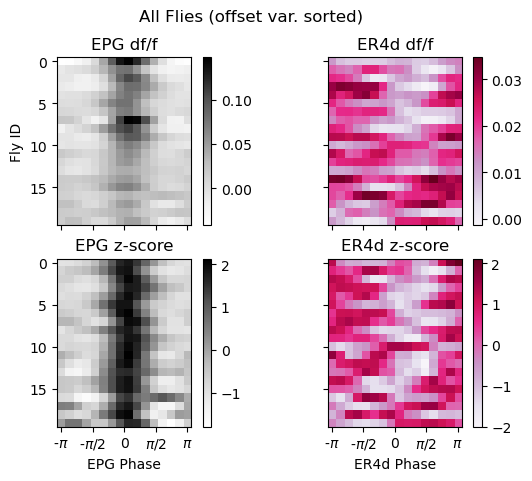

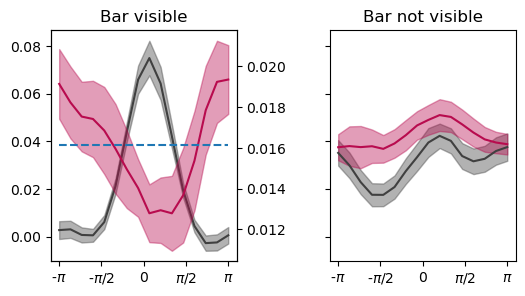

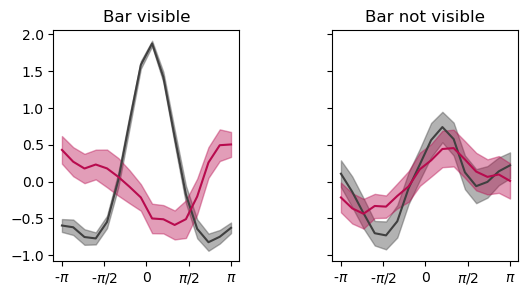

In [9]:
print(len(epg_all))
epg_all = np.array(epg_all)
epg_all_b = np.array(epg_all_b)
r4d_all = np.array(r4d_all)
r4d_all_b = np.array(r4d_all_b)

# fig, ax = plt.subplots()
# ax.imshow(epg_all)
shifts = []
for r in range(epg_all.shape[0]):
    row = epg_all[r,:]
    shift = np.argmax(row)
    # shift = int(np.round(sp.ndimage.center_of_mass(row)[0]))
    shifts.append(shift)
    shift_b = np.argmax(epg_all_b[r,:])
    
    epg_all[r,:] = np.roll(row,-shift+8)
    epg_all_b[r,:] = np.roll(epg_all_b[r,:],-shift+8)
    r4d_all[r,:] = np.roll(r4d_all[r,:],-shift+8)
    r4d_all_b[r,:] = np.roll(r4d_all_b[r,:],-shift+8)
    
    # epg_all[r,:] = np.roll(row,-shift_b+8)
    # epg_all_b[r,:] = np.roll(epg_all_b[r,:],-shift+8)
    # r4d_all[r,:] = np.roll(r4d_all[r,:],-shift_b+8)
    # r4d_all_b[r,:] = np.roll(r4d_all_b[r,:],-shift_b+8)
    

offset_sort = np.argsort(np.array(offset_all))
offset_s = np.array(offset_all)[offset_sort]
print(offset_sort)
epg_all_s = epg_all[offset_sort,:]
epg_all_sb = epg_all_b[offset_sort,:]
r4d_all_s = r4d_all[offset_sort,:]
r4d_all_sb = r4d_all_b[offset_sort,:]

fig, ax = plt.subplots(2,2, sharex=True, sharey=True)
h = ax[0,0].imshow(epg_all_s, cmap='Greys')
ax[0,0].set_title('EPG df/f')
fig.colorbar(h)
h = ax[0,1].imshow(r4d_all_s, cmap='PuRd')
ax[0,1].set_title('ER4d df/f')
fig.colorbar(h)
ax[0,0].set_ylabel('Fly ID')
ax[1,0].set_xlabel('EPG Phase')
ax[1,1].set_xlabel('ER4d Phase')
ax[0,0].set_xticks([r/2/np.pi*15 for r in (0,  np.pi/2,  np.pi,  6*np.pi/4,  2*np.pi)], 
                                                 labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])
fig.suptitle('All Flies (offset var. sorted)')

epg_all_z = sp.stats.zscore(epg_all_s,axis=1)
r4d_all_z = sp.stats.zscore(r4d_all_s,axis=1)
epg_all_b_z = sp.stats.zscore(epg_all_sb, axis=1)
r4d_all_b_z = sp.stats.zscore(r4d_all_sb, axis=1)



# fig, ax = plt.subplots(1,2)
h = ax[1,0].imshow(epg_all_z, cmap='Greys')
ax[1,0].set_title('EPG z-score')
fig.colorbar(h)
h = ax[1,1].imshow(r4d_all_z, cmap='PuRd')
ax[1,1].set_title('ER4d z-score')
fig.colorbar(h)

fig.savefig(figfolder / 'heading_centered_avg_heatmap_bt.pdf', format='pdf')
fig.savefig(figfolder / 'heading_centered_avg_heatmap_bt.png', format='png')


fig,ax = plt.subplots(1,2, figsize=[6,3], sharex=True, sharey=True)
x = np.arange(16)
ax[0].plot(x,epg_all_s.mean(axis=0), color=plt.cm.Greys(.8))
mu, sem = epg_all_s.mean(axis=0), sp.stats.sem(epg_all_s, axis=0)
ax[0].fill_between(x, mu-sem, mu+sem, color=plt.cm.Greys(.8), alpha=.4)

axx = ax[0].twinx()
# axx.set_ylim([-.01,.09])
# ax[0].set_ylim([-.01,.09])
axx.plot(r4d_all_s.mean(axis=0), color=plt.cm.PuRd(.8))
axx.plot([0,15], r4d_all_s.mean(axis=0).mean()*np.ones((2,)), linestyle='--')
mu, sem = r4d_all_s.mean(axis=0), sp.stats.sem(r4d_all_s, axis=0)
axx.fill_between(x, mu-sem, mu+sem, color=plt.cm.PuRd(.8), alpha=.4)
ax[0].set_title('Bar visible')
# t,p = sp.stats.ttest_rel(r4d_all_s[:,[2,3,4,5,11,12,13,14]].mean(axis=-1), r4d_all_s[:,[7,8,9]].mean(axis=-1))
t,p = sp.stats.ttest_rel(r4d_all_s[:,[0,1,2,3,4,12,15,14,13]].mean(axis=-1), r4d_all_s[:,[7,8,9]].mean(axis=-1))
print(t,p)
# fig,ax = plt.subplots(1,2, sharex=True, sharey=True)


# axx = ax[1].twinx()
# axx.set_ylim([-.01,.09])
# ax[1].set_ylim([-.01,.09])
ax[1].plot(x,epg_all_sb.mean(axis=0), color=plt.cm.Greys(.8))
mu, sem = epg_all_sb.mean(axis=0), sp.stats.sem(epg_all_sb, axis=0)
ax[1].fill_between(x, mu-sem, mu+sem, color=plt.cm.Greys(.8), alpha=.4)


# axx = ax.twinx()
ax[1].plot(r4d_all_sb.mean(axis=0), color=plt.cm.PuRd(.8))
mu, sem = r4d_all_sb.mean(axis=0), sp.stats.sem(r4d_all_sb, axis=0)
ax[1].fill_between(x, mu-sem, mu+sem, color=plt.cm.PuRd(.8), alpha=.4)

ax[0].set_xticks([r/2/np.pi*15 for r in (0,  np.pi/2,  np.pi,  6*np.pi/4,  2*np.pi)], 
                                                 labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])
ax[1].set_title('Bar not visible')
# ax[0].set_ylim([-.02, .12])

fig.subplots_adjust(wspace=.5)
fig.savefig(figfolder / 'heading_centered_avg_summary_bt.png', format='png')

fig,ax = plt.subplots(1,2, figsize=[6,3], sharex=True, sharey=True)
x = np.arange(16)
ax[0].plot(x,epg_all_z.mean(axis=0), color=plt.cm.Greys(.8))
mu, sem = epg_all_z.mean(axis=0), sp.stats.sem(epg_all_z, axis=0)
ax[0].fill_between(x, mu-sem, mu+sem, color=plt.cm.Greys(.8), alpha=.4)

# axx = ax[0].twinx()
# axx.set_ylim([-1,2])
# ax[0].set_ylim([-1,2])
ax[0].plot(r4d_all_z.mean(axis=0), color=plt.cm.PuRd(.8))
# axx.plot([0,15], r4d_all_z.mean(axis=0).mean()*np.ones((2,)), linestyle='--')
mu, sem = r4d_all_z.mean(axis=0), sp.stats.sem(r4d_all_z, axis=0)
ax[0].fill_between(x, mu-sem, mu+sem, color=plt.cm.PuRd(.8), alpha=.4)
ax[0].set_title('Bar visible')
# t,p = sp.stats.ttest_rel(r4d_all_z[:,[4,5,6,10,11,12]].mean(axis=-1), r4d_all_z[:,[7,8,9]].mean(axis=-1))
t,p = sp.stats.ttest_rel(r4d_all_z[:,[0,1,2,15,14,13]].mean(axis=-1), r4d_all_z[:,[6,7,8,9]].mean(axis=-1))
print(t,p)
# fig,ax = plt.subplots(1,2, sharex=True, sharey=True)


# axx = ax[1].twinx()
# axx.set_ylim([-.8,.8])
ax[1].plot(x,epg_all_b_z.mean(axis=0), color=plt.cm.Greys(.8))
mu, sem = epg_all_b_z.mean(axis=0), sp.stats.sem(epg_all_b_z, axis=0)
ax[1].fill_between(x, mu-sem, mu+sem, color=plt.cm.Greys(.8), alpha=.4)


# axx = ax.twinx()
ax[1].plot(r4d_all_b_z.mean(axis=0), color=plt.cm.PuRd(.8))
mu, sem = r4d_all_b_z.mean(axis=0), sp.stats.sem(r4d_all_b_z, axis=0)
ax[1].fill_between(x, mu-sem, mu+sem, color=plt.cm.PuRd(.8), alpha=.4)

ax[0].set_xticks([r/2/np.pi*15 for r in (0,  np.pi/2,  np.pi,  6*np.pi/4,  2*np.pi)], 
                                                 labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])
ax[1].set_title('Bar not visible')
# ax[0].set_ylim([-.02, .12])

fig.subplots_adjust(wspace=.5)
# fig.savefig(figfolder / 'heading_centered_avg_summary_z_bt.pdf', format='pdf')

(array([3., 2., 6., 0., 1., 0., 3., 5.]),
 array([-8.   , -6.125, -4.25 , -2.375, -0.5  ,  1.375,  3.25 ,  5.125,
         7.   ]),
 <BarContainer object of 8 artists>)

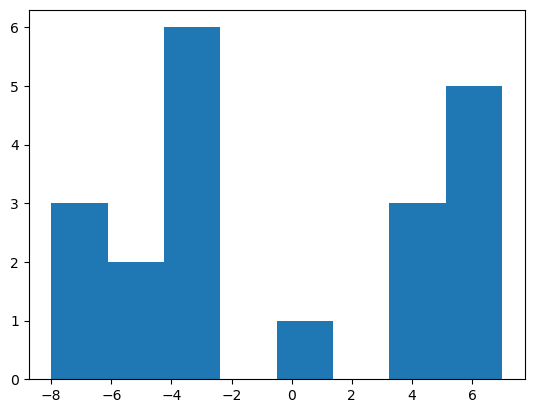

In [10]:
fig, ax = plt.subplots()
ax.hist(np.argmax(r4d_all[:,:],axis=1)-8,bins=8)

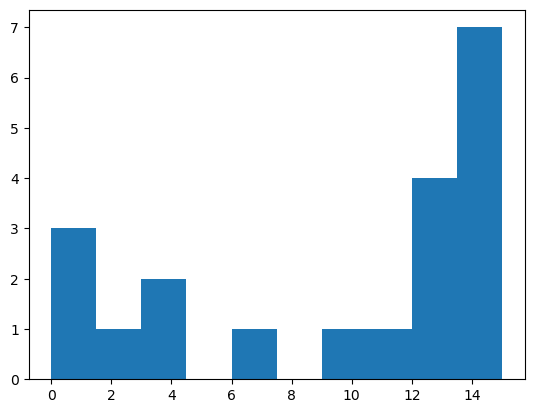

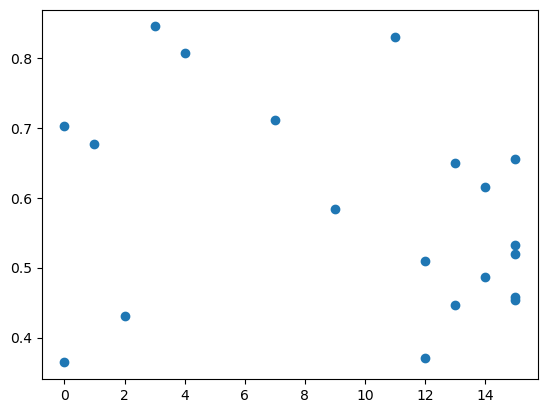

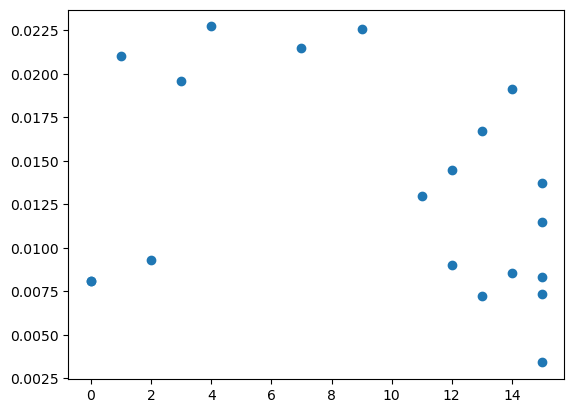

In [11]:
fig, ax = plt.subplots()
ax.hist(shifts)

fig, ax = plt.subplots()
ax.scatter(shifts, offset_all)

fig, ax= plt.subplots()
ax.scatter(shifts, r4d_all[:,[7,8,9]].mean(axis=-1))

In [12]:
print(offset_s)
print((offset_s>.6).sum())
print((offset_s<.6).sum())

[0.36446414 0.37124433 0.4315441  0.44646726 0.45410446 0.45795462
 0.48720916 0.50999707 0.51958947 0.53216333 0.584163   0.6149494
 0.64932313 0.65464644 0.67724108 0.70181531 0.71130994 0.80625899
 0.82903912 0.8447835 ]
9
11


2.563618082339068 0.02819764882782112
2.216767243877432 0.050972998511660594


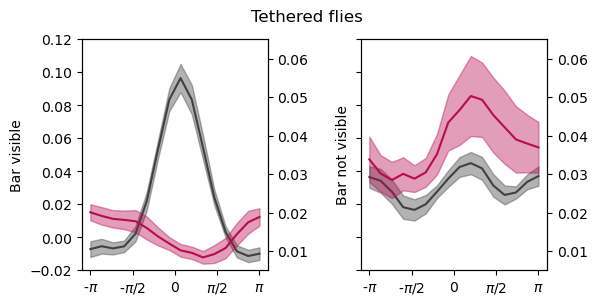

In [13]:
offset_mask = offset_s<.6
fig,ax = plt.subplots(1,2, figsize=[6,3], sharex=True, sharey=True)
x = np.arange(16)
ax[0].plot(x,epg_all_s[offset_mask,:].mean(axis=0), color=plt.cm.Greys(.8))
mu, sem = epg_all_s[offset_mask,:].mean(axis=0), sp.stats.sem(epg_all_s[offset_mask,:], axis=0)
ax[0].fill_between(x, mu-sem, mu+sem, color=plt.cm.Greys(.8), alpha=.4)

axx = ax[0].twinx()
axx.set_ylim([.005,.065])
axx.plot(r4d_all_s[offset_mask,:].mean(axis=0), color=plt.cm.PuRd(.8))
mu, sem = r4d_all_s[offset_mask,:].mean(axis=0), sp.stats.sem(r4d_all_s[offset_mask,:], axis=0)
axx.fill_between(x, mu-sem, mu+sem, color=plt.cm.PuRd(.8), alpha=.4)
ax[0].set_ylabel('Bar visible')
t,p = sp.stats.ttest_rel(r4d_all_s[offset_mask,:][:,[0,1,2,15,14,13]].mean(axis=-1), r4d_all_s[offset_mask,:][:,[7,8,9]].mean(axis=-1))
print(t,p)
t,p = sp.stats.ttest_rel(r4d_all_z[offset_mask,:][:,[0,1,2,15,14,13]].mean(axis=-1), r4d_all_z[offset_mask,:][:,[7,8,9]].mean(axis=-1))
print(t,p)
# fig,ax = plt.subplots(1,2, sharex=True, sharey=True)

ax[1].plot(x,epg_all_sb[offset_mask,:].mean(axis=0), color=plt.cm.Greys(.8))
mu, sem = epg_all_sb[offset_mask,:].mean(axis=0), sp.stats.sem(epg_all_sb[offset_mask,:], axis=0)
ax[1].fill_between(x, mu-sem, mu+sem, color=plt.cm.Greys(.8), alpha=.4)


axx = ax[1].twinx()
axx.set_ylim([.005,.065])
axx.plot(r4d_all_sb[offset_mask,:].mean(axis=0), color=plt.cm.PuRd(.8))
mu, sem = r4d_all_sb[offset_mask,:].mean(axis=0), sp.stats.sem(r4d_all_sb[offset_mask,:], axis=0)
axx.fill_between(x, mu-sem, mu+sem, color=plt.cm.PuRd(.8), alpha=.4)

ax[0].set_xticks([r/2/np.pi*15 for r in (0,  np.pi/2,  np.pi,  6*np.pi/4,  2*np.pi)], 
                                                 labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])
ax[1].set_ylabel('Bar not visible')
ax[0].set_ylim([-.02, .12])
# ax[0].set_ylim([-.02,.13])

fig.suptitle('Tethered flies')
fig.subplots_adjust(hspace=1)
fig.subplots_adjust(wspace=.5)
fig.savefig(figfolder / 'heading_centered_avg_tethered_0.5.pdf', format='pdf')


1.1148127813113442 0.297297827465534
1.451739828771488 0.18463405083284634


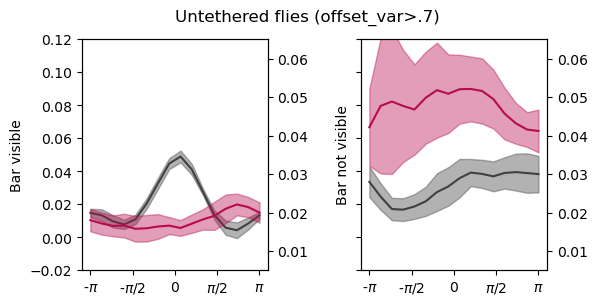

In [14]:
offset_mask = offset_s>=.6
fig,ax = plt.subplots(1,2, figsize=[6,3], sharex=True, sharey=True)
x = np.arange(16)
ax[0].plot(x,epg_all_s[offset_mask,:].mean(axis=0), color=plt.cm.Greys(.8))
mu, sem = epg_all_s[offset_mask,:].mean(axis=0), sp.stats.sem(epg_all_s[offset_mask,:], axis=0)
ax[0].fill_between(x, mu-sem, mu+sem, color=plt.cm.Greys(.8), alpha=.4)

axx = ax[0].twinx()
axx.set_ylim([.005,.065])
axx.plot(r4d_all_s[offset_mask,:].mean(axis=0), color=plt.cm.PuRd(.8))
mu, sem = r4d_all_s[offset_mask,:].mean(axis=0), sp.stats.sem(r4d_all_s[offset_mask,:], axis=0)
axx.fill_between(x, mu-sem, mu+sem, color=plt.cm.PuRd(.8), alpha=.4)
ax[0].set_ylabel('Bar visible')
t,p = sp.stats.ttest_rel(r4d_all_s[offset_mask,:][:,[0,1,2,15,14,13]].mean(axis=-1), r4d_all_s[offset_mask,:][:,[6,7,8,9,10]].mean(axis=-1))
print(t,p)
t,p = sp.stats.ttest_rel(r4d_all_z[offset_mask,:][:,[0,1,2,15,14,13]].mean(axis=-1), r4d_all_z[offset_mask,:][:,[6,7,8,9,10]].mean(axis=-1))
print(t,p)
# fig,ax = plt.subplots(1,2, sharex=True, sharey=True)

ax[1].plot(x,epg_all_sb[offset_mask,:].mean(axis=0), color=plt.cm.Greys(.8))
mu, sem = epg_all_sb[offset_mask,:].mean(axis=0), sp.stats.sem(epg_all_sb[offset_mask,:], axis=0)
ax[1].fill_between(x, mu-sem, mu+sem, color=plt.cm.Greys(.8), alpha=.4)


axx = ax[1].twinx()
axx.set_ylim([.005,.065])
axx.plot(r4d_all_sb[offset_mask,:].mean(axis=0), color=plt.cm.PuRd(.8))
mu, sem = r4d_all_sb[offset_mask,:].mean(axis=0), sp.stats.sem(r4d_all_sb[offset_mask,:], axis=0)
axx.fill_between(x, mu-sem, mu+sem, color=plt.cm.PuRd(.8), alpha=.4)

ax[0].set_xticks([r/2/np.pi*15 for r in (0,  np.pi/2,  np.pi,  6*np.pi/4,  2*np.pi)], 
                                                 labels = [r'-$\pi$',  r'-$\pi$/2',  '0',  r'$\pi$/2',  r'$\pi$'])
ax[1].set_ylabel('Bar not visible')
ax[0].set_ylim([-.02, .12])

fig.suptitle('Untethered flies (offset_var>.7)')
fig.subplots_adjust(wspace=.5)
fig.savefig(figfolder / 'heading_centered_avg_summary_untethered_.7.pdf', format='pdf')

In [15]:

r4d_diff = (-r4d_all_s[:,[0,1,2, 3,4,5,11,12,13,14,15]].mean(axis=-1) + r4d_all_s[:,[7,8,9]].mean(axis=-1))/np.linalg.norm(r4d_all_s,axis=-1)
print(r4d_diff)

[-0.00611218  0.04670214 -0.09824395 -0.16518398 -0.15456562 -0.14871829
 -0.09630657 -0.02226926 -0.22505179 -0.13248068  0.1616488  -0.02656793
 -0.04584678 -0.08918616 -0.07057557 -0.15615417 -0.03945326  0.06135071
  0.09726238  0.09467181]


LinregressResult(slope=0.022556275343294015, intercept=0.00011931608465979432, rvalue=0.5507708445152715, pvalue=0.011846312521168282, stderr=0.008056900000943923, intercept_stderr=0.004834330069238919)
0.5507708445152713 0.011846312521168339
LinregressResult(slope=1.4861463468010077, intercept=-1.2759923593382023, rvalue=0.2891270338843266, pvalue=0.21631907890628907, stderr=1.1597929972050582, intercept_stderr=0.6959031587613429)


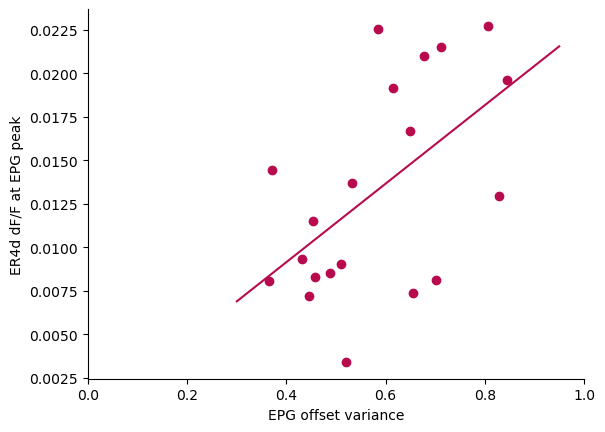

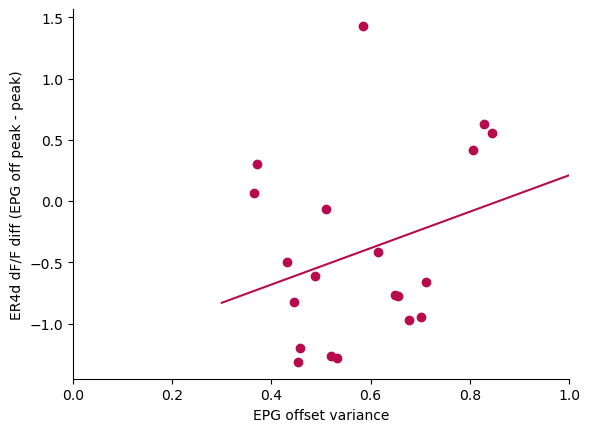

In [16]:
fig, ax= plt.subplots()
# r4d_frac_peak = r4d_all_s[:,[7,8,9]].mean(axis=-1)#/np.linalg.norm(r4d_all_s,axis=-1)
r4d_frac_peak = r4d_all_s[:,[7,8,9]].mean(axis=-1) 
epg_frac = epg_all_s[:,[7,8,9]].mean(axis=-1) - epg_all_s[:,[0,1,2, 3,4,5,11,12,13,14,15]].mean(axis=-1) 
ax.scatter(offset_s, r4d_frac_peak, color=plt.cm.PuRd(.8) )
# ax.set_ylim([-.005,.025])
ax.set_xlim([0,1])
ax.set_ylabel('ER4d dF/F at EPG peak')
ax.set_xlabel('EPG offset variance')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

res = sp.stats.linregress(offset_s,  r4d_frac_peak)
x = np.linspace(.3,.95)
ax.plot(x, res.slope*x + res.intercept, color=plt.cm.PuRd(.8))
print(res)
# r,p = sp.stats.pearsonr(offset_s, r4d_all_s[:,[7,8,9]].mean(axis=-1)/r4d_all_s)
r,p = sp.stats.pearsonr(offset_s, r4d_frac_peak)


print(r,p)
fig.savefig(figfolder / 'r4d_trough_dff_vs_epg_offset_var.pdf', format='pdf')

fig, ax= plt.subplots()
ax.scatter(offset_s, r4d_all_z[:,[7,8,9]].mean(axis=-1), color = plt.cm.PuRd(.8))
# ax.set_ylim([-.13, .3])
ax.set_xlim([0,1])
ax.set_ylabel('ER4d dF/F diff (EPG off peak - peak)')
ax.set_xlabel('EPG offset variance')
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)

res = sp.stats.linregress(offset_s,  r4d_all_z[:,[7,8,9]].mean(axis=-1))
x = np.linspace(.3,1)
ax.plot(x, res.slope*x + res.intercept, color=plt.cm.PuRd(.8))
print(res)
fig.savefig(figfolder / 'r4d_dff_diff_vs_epg_offset_var.pdf', format='pdf')